<a href="https://colab.research.google.com/github/spetryk/ai4all2020/blob/master/2-Exploring%20the%20fake%20image%20space.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# How to explore the input space to a generator
Inspired by [this](https://machinelearningmastery.com/how-to-interpolate-and-perform-vector-arithmetic-with-faces-using-a-generative-adversarial-network/) tutorial by Jason Brownlee. We also use pretrained models from [this github repo](https://github.com/huggingface/pytorch-pretrained-BigGAN) created by the company Hugging Face, which is most known for making large natural language processing models easily accessible.

Recall that generators learn to map points in the space of **random noise** to the space of **images**. We call this random-noise-space the "latent" space, latent meaning "hidden". It's hidden because to us, the noise doesn't have any meaning - it's literally random numbers. It only has meaning to the generator model, which has been trained to create meaning out of these random numbers.


So, what does it mean to "explore" the latent space? Say your generator has been trained to create a variety of different classes (like different animals). Say also that you also have a noise vector that generates a cat, and you want to make the cat look more like a walrus (what has deep learning come to...). Somewhere in the latent space there's a cluster of vectors that create cats, and somewhere else a cluster that creates walruses. From your cat vector, you can find where the walrus cluster is, and "take a step" in that direction. Then, you can pass that new vector into the generator and see what happens!

![midpt example](resources/midpt.png)

Mathematically, how does this work? It's all about **vector arithmetic**. If you have two vectors (or points in space) you can draw a line between them, and **find the midpoint**.

In our case, those two points in space are two different noise vectors. We can "draw a line" between them and find the midpoint. What happens if we now pass the midpoint through the generator? We should get the "average" of the two images!

Let's try it out. First, we'll import the necessary packages and load up a generator that has already been trained.


In [ ]:
# Install pretrained BigGAN model
! pip install pytorch-pretrained-biggan
! pip install nltk

In [18]:
%matplotlib inline
from tools import *
import torch
import torchvision.utils as vutils

import numpy as np
from tqdm.notebook import tqdm

# Packages for visualization
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from matplotlib.animation import PillowWriter

# Pretrained BigGAN models from huggingface repo (the github link at the top of this file)
from pytorch_pretrained_biggan import BigGAN as huggingface_BigGAN
from pytorch_pretrained_biggan import BigGAN, one_hot_from_names, truncated_noise_sample, convert_to_images
from pytorch_pretrained_biggan import convert_to_images as convert_to_PIL

# Package that matches class names (like "leopard") into the correct class number that BigGAN uses
import nltk
nltk.download('wordnet')



# Function that converts PyTorch tensor to correct format to give to generator
class BigGAN():
    def __init__(self, resolution):
        assert resolution in ['128', '256', '512'], 'Resolution must be 128, 256, or 512'
        self.biggan = huggingface_BigGAN.from_pretrained('biggan-deep-{}'.format(resolution))
        
    def __call__(self, noise_vector, class_vector, truncation):
        # Just Pytorch syntax: BigGAN requires 4D input, so use 'unsqueeze' function
        # to convert from 3D to 4D
        if len(noise_vector.shape) == 3:
            noise_vector = noise_vector.unsqueeze(0)
        if len(class_vector.shape) == 3:
            class_vector = class_vector.unsqueeze(0)
        output = self.biggan(noise_vector, class_vector, truncation)
        return output
            
        

        
# Function that converts the output of the GAN into images that we can plot
def convert_to_images(biggan_output):
    images = convert_to_PIL(biggan_output.cpu())
    images = [np.array(image) for image in images]
    return images


# Function that helps with saving a GIF
# from https://stackoverflow.com/questions/51512141/how-to-make-matplotlib-saved-gif-looping
class LoopingPillowWriter(PillowWriter):
    def finish(self):
        self._frames[0].save(
            self._outfile, save_all=True, append_images=self._frames[1:],
            duration=int(1000 / self.fps), loop=0)

[nltk_data] Downloading package wordnet to /home/spetryk/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [19]:
# Load the pretrained BigGAN model
generator = BigGAN(resolution=512)

# Use a GPU if available
device = 'cuda:1' if torch.cuda.is_available() else 'cpu'
print('Using device {}'.format(device))


Using device cuda:1


## Generate 2 images with BigGAN

BigGAN was created by researchers in the company DeepMind. Here's the [research paper](https://arxiv.org/pdf/1809.11096.pdf) if you're curious - check out the Appendix to see generated image samples and some failure cases.


BigGAN is a type of GAN that has been trained to take in a noise vector along with a **class vector**, so you can specify the class of image that you want to generate. A class vector is "one-hot", meaning it contains all 0's except for the index of the class number, which contains a 1.

For example, if there were 5 classes, and you want to generate class number 1, it would look like this (recall that index positions start at 0):
```
class_vector_example = [0, 1, 0, 0, 0]
```

BigGAN has 1000 classes (!!!). The possible classes are listed at the bottom of this notebook. Specify the name of the 2 classes you want to generate in the `classes` list.

The `truncation` value is another input to BigGAN. You can change this value too, keeping it within [0,2]. Larger values create more diverse samples, though smaller values are usually visually better looking. If you're curious, there is a longer explanation of what this is at the bottom of this notebook.


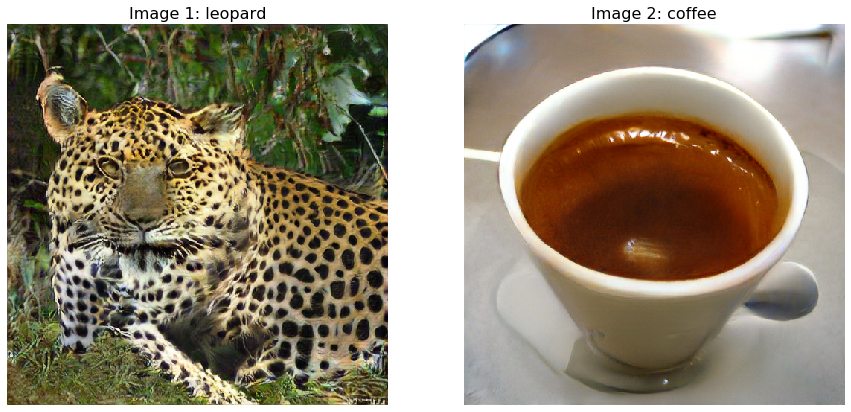

In [20]:
# TODO: you can change these classes
classes = ['leopard', 'coffee']

# You can change this truncation value as well, within the range [0,2]
truncation = 0.4

# Prepare an input
class_vectors = one_hot_from_names(classes, batch_size=len(classes))
noise_vectors = truncated_noise_sample(truncation=truncation, batch_size=len(classes))

# All in PyTorch tensors on the correct device
noise_vectors = torch.from_numpy(noise_vectors).to(device)
class_vectors = torch.from_numpy(class_vectors).to(device)
generator.to(device)

# Pass noise through generator and visualize the images it creates
with torch.no_grad():
    output = generator(noise_vectors, class_vectors, truncation)

images = convert_to_images(output)

# Plot the generated images    
fig, ax = plt.subplots(1,2,figsize=(15,10))
for column in range(2):
    ax[column].axis('off')

ax[0].set_title('Image 1: {}'.format(classes[0]), fontsize=16)
ax[1].set_title('Image 2: {}'.format(classes[1]), fontsize=16)
ax[0].imshow(images[0])
ax[1].imshow(images[1])
plt.show()


## Exercise 1: Averaging in pixel space vs. latent space

Let's first average the two images together in pixel space, as opposed to the latent space. Hopefully this will help you appreciate that finding the average between two different images isn't that simple without a GAN.

Next, we'll average the two noise vectors. We also have to average the two class vectors. Then, use the generator to create the midway image.

#### Useful functions

`convert_to_images(generator_output)`: converts BigGAN output to images that we can plot

#### Useful variables
`images`: list with the two images in pixel space

`noise_vectors`: list with the two noise vectors

`class_vectors`: list with the two class vectors



In [21]:
def calculate_average(a, b):
    # TODO: Calculate the average between PyTorch Tensors a and b.

    average = (a+b)/2
    
    return average



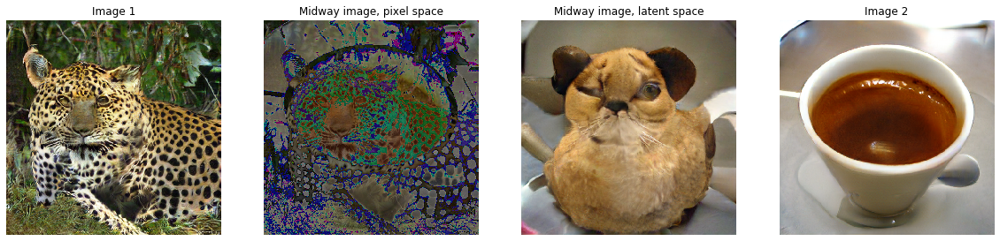

In [22]:
# Calculate the average between the two images in pixel space
midway_from_pixels = calculate_average(images[0], images[1])# TODO


# Calculate the average between the two noise vectors and the two class vectors
midway_noise_vector = calculate_average(noise_vectors[0], noise_vectors[1])# TODO
midway_class_vector = calculate_average(class_vectors[0], class_vectors[1])# TODO


# Passing the midway noise and class through the generator
midway_from_latent = generator(midway_noise_vector, midway_class_vector, truncation)# TODO

# Converting the generator output to image we can plot
midway_from_latent = convert_to_images(midway_from_latent) # TODO


# Plotting the images
fig, ax = plt.subplots(1,4,figsize=(20,10))
for column in range(4):
    ax[column].axis('off')

ax[0].set_title('Image 1')
ax[1].set_title('Midway image, pixel space')
ax[2].set_title('Midway image, latent space')
ax[3].set_title('Image 2')

ax[0].imshow(images[0])
ax[1].imshow(midway_from_pixels.astype(int))
ax[2].imshow(midway_from_latent[0])
ax[3].imshow(images[1])


# Save figure
plt.savefig('midway_images.png')
plt.show()


Looks cool! (hopefully you are impressed..)


But wait - there is a whole **line** of points between Image 1 and Image 2. Right now, we're only visualizing the middle point. Which brings us to:

## Exercise 2: Transitioning smoothly between images

You know how the motion in a video looks like it's smooth, but it's really just a bunch of frames playing one after another? We'll do the same thing here to make a smooth interpolation between Image 1 and 2.

To code this up, we'll define the number of frames we want, calculate each frame, put them into a list, and loop through the list to create a video.

Hint: [This function](https://pytorch.org/docs/master/generated/torch.linspace.html) will be helpful!



In [23]:
def interpolate(a, b, fraction_of_b):
    # TODO return a vector that mixes a and b together, according to fraction_of_b
    # e.g. if fraction_of_b = 0.5, this would return the midway point we did earlier
    
    
    output = (1-fraction_of_b)*a + fraction_of_b*b
    
    return output

In [30]:

# TODO: you can change how many frames you want
num_frames = 40

# Initialize frames to empty list. We'll add on to it each iteration of the loop.
frames = []

fractions = np.linspace(0,1,num_frames) # TODO

for i in range(num_frames):
    # Calculate what each frame should be
    
    fraction_of_b = fractions[i] # TODO
    noise_vector = interpolate(noise_vectors[0], noise_vectors[1], fraction_of_b)# TODO
    class_vector = interpolate(class_vectors[0], class_vectors[1], fraction_of_b)


    # Pass through generator
    frame = generator(noise_vector.unsqueeze(0), class_vector.unsqueeze(0), truncation)
    
    # Convert generator output to image
    frame = convert_to_images(frame)
    
    # Append the image to the frames list
    frames.append(frame[0])
    


Animation size has reached 21157879 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


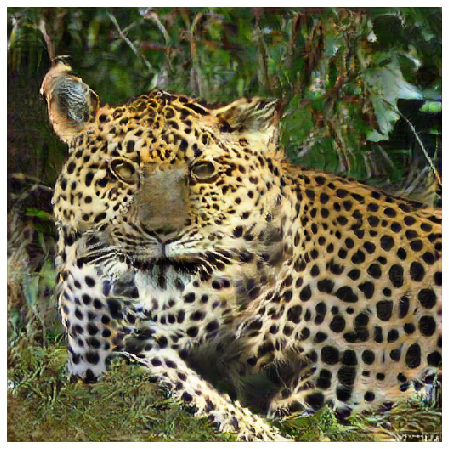

In [31]:
# Visualize progression

# Hack: to make gif go from A -> B -> A,
# add a backwards list to the end of the list
frames_viz = frames + frames[::-1][1:]

# Plot
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(frame, animated=True)] for frame in frames_viz]
ani = animation.ArtistAnimation(fig, ims, interval=100, repeat_delay=0, blit=True)
#ani.save('interpolation_biggan.gif', writer=LoopingPillowWriter(fps=10))

HTML(ani.to_jshtml())




# TODO GAN class list, truncation explanation